## Setup

In [2]:
# Load packages and classes
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import tiffslide
import seaborn as sns
import gget
import tifffile
import zarr
import matplotlib
# MosaicDataset and BruceDataset classes allow loading and visualisation of the different data sources
from gbmhackathon import MosaicDataset, BruceDataset
import scanpy as sc

## Start exploring the MOSAIC data

In [3]:
# Look at the available data sources
MosaicDataset.sources.keys()

dict_keys(['clinical', 'bulk_rna', 'spatial', 'sc_rna', 'wes', 'he'])

In [4]:
# The following cell will returns a dictionary with the data sources in the
# keys and the list of files (and path) used to return the data.
source_dict_mosaic = MosaicDataset.load_tabular()

In [5]:
source_dict_mosaic.keys()

dict_keys(['clinical', 'bulk_rna', 'wes', 'he'])

In [6]:
filename_sample_table = "/home/ec2-user/SageMaker/data/mosaic_dataset/Data availibility per modality per patient.csv"
sample_table = pd.read_csv(filename_sample_table, index_col=0)
sample_table.head(10)

,Visium_usable,WES_usable,scRNAseq_usable,bulkRNAseq_usable,HE_usable,Clinical_usable
Hackathon_ID,,,,,,
HK_G_001a,Yes,Yes,Yes,Yes,Yes,Yes
HK_G_002a,Yes,Yes,Yes,Yes,Yes,Yes
HK_G_003a,Yes,Yes,Yes,Yes,Yes,Yes
HK_G_004a,Yes,Yes,Yes,Yes,Yes,Yes
HK_G_005a,Yes,Yes,Yes,Yes,Yes,Yes
HK_G_006a,Yes,Yes,Yes,Yes,Yes,Yes
HK_G_007a,Yes,Yes,Yes,Yes,Yes,Yes
HK_G_008a,Yes,Yes,Yes,Yes,Yes,Yes
HK_G_009a,Yes,Yes,Yes,Yes,Yes,Yes


# Load clinical data

In [7]:
# To access the clinical data, specify the correct keys
clin_df = source_dict_mosaic["clinical"]["processed gbm clinical"]
clin_df.head(2)
clin_df.shape

(114, 40)

In [8]:
# For the clinical data, you also have access to a dictionary to understand the
# variable's name
data_dict = source_dict_mosaic["clinical"]["data dictionary"]
data_dict.head(10)

,File name,Field name,Note
0,sample_and_clinical_data,sample_id,Unique identifier for each biological sample c...
1,sample_and_clinical_data,patient_id,Unique identifier assigned to each patient in ...
2,sample_and_clinical_data,cohort_code,Code representing the cohort to which the pati...
3,sample_and_clinical_data,cancer_indication,Specific tumor type diagnosed in the patient.
4,sample_and_clinical_data,sample_source,The method from which the sample was obtained ...
5,sample_and_clinical_data,sample_origin,Indicates whether the sample is from the prima...
6,sample_and_clinical_data,sample_collection_chronology,Timing of sample collection relative to diagno...
7,sample_and_clinical_data,administrative_gender,_
8,sample_and_clinical_data,smoking_status,_
9,sample_and_clinical_data,smoking_quantity_pack_years,_


In [9]:
source_dict_mosaic["clinical"]["processed gbm clinical"].columns

Index(['patient_id', 'cohort_code', 'cancer_indication', 'sample_source',
       'sample_origin', 'sample_collection_chronology',
       'administrative_gender', 'smoking_status',
       'smoking_quantity_pack_years', 'alcohol_intake', 'os_years',
       'os_censor', 'pfs_years', 'pfs_censor', 'age_at_diagnosis_years',
       'primary_tumour_side', 'number_of_brain_tumour_sites',
       'largest_diameter_of_the_primary_tumour_mm_duplicated_0',
       'surgery_type', 'tumour_resection_chronology',
       'microvascular_proliferation', 'necrosis', 'presence_of_small_cells',
       'atrx_loss_of_expression_ihc', 'atrx_mutation', 'braf_mutation', 'gfap',
       'olig2', 'p53', 'idh1_idh2_mutation', 'idh1_r132h_expression_ihc',
       'tert_promoter_mutation', 'mgmt_promoter_methylation', 'egfr_mutation',
       'egfr_amplification', 'pten_mutation', 'ntrk_fusion',
       'histone_h3_g34_mutation_sequencing',
       'histone_h3_k27m_mutation_sequencing',
       'time_interval_sample_harvest

In [10]:
import re

def correct_patient_id(sample_id):
    match = re.match(r"(.*)b$", sample_id)
    if match:
        base_id = match.group(1)  # remove "b"
        numeric_part = re.search(r"(\d+)", base_id)  # extract numeric part
        if numeric_part:
            num_str = numeric_part.group(0)
            new_num = str(int(num_str) - 1).zfill(len(num_str))
            corrected_id = base_id.replace(num_str, new_num)
            return corrected_id
    return sample_id[:-1]  # remove last letter for "a" samples
    
clin_df["corrected_patient_id"] = clin_df.index.map(correct_patient_id)

In [11]:
clin_df["corrected_patient_id"]

sample_id
HK_G_001a    HK_G_001
HK_G_002a    HK_G_002
HK_G_003a    HK_G_003
HK_G_004a    HK_G_004
HK_G_005a    HK_G_005
               ...   
HK_G_111b    HK_G_110
HK_G_112a    HK_G_112
HK_G_113b    HK_G_112
HK_G_114a    HK_G_114
HK_G_115b    HK_G_114
Name: corrected_patient_id, Length: 114, dtype: object

# Load single-cell data

In [12]:
# Note that it can take up to 12 minutes to load the single-cell data because it is heavy
single_cell_obj = MosaicDataset.load_singlecell()
# Display the content of the anndata object
single_cell_obj.__dict__.keys()

dict_keys(['_is_view', '_adata_ref', '_oidx', '_vidx', 'file', '_X', '_obs', '_var', '_uns', '_obsm', '_varm', '_obsp', '_varp', '_raw', '_layers'])

In [13]:
# .layers["ambient_rna_removed"] contains the unnormalised counts
single_cell_obj.layers["ambient_rna_removed"]

<Compressed Sparse Row sparse matrix of dtype 'float64'
	with 1132239414 stored elements and shape (620451, 17842)>

In [14]:
# .layers["LogNormalize"] contains log-normalised counts
single_cell_obj.layers["LogNormalize"]

<Compressed Sparse Row sparse matrix of dtype 'float64'
	with 1132239414 stored elements and shape (620451, 17842)>

In [15]:
# .X contains the log of the SCTransform-corrected counts plus one
single_cell_obj.X

<Compressed Sparse Row sparse matrix of dtype 'float64'
	with 848560087 stored elements and shape (620451, 17842)>

The `.obs` property contains cell-level meta-data. Each row represents a cell. The most useful columns are:
- `orig.ident` The sample ID.
- `celltype_level1_scanvi` Level 1 cell type annotations. These are the annotations at the lowest resolution, and comprise the following five cell types: *Immune*, *Malignant*, *Neuroglia*, *Neuron*, *Stromal*.
- `celltype_level2_scanvi` Level 2 cell type annotations. These are higher resolution than level 1 annotations.
- `celltype_level3_scanvi` Level 3 cell type annotations. Malignant cells from each sample are annotated separately, for example, *Tu_HK_G_001* are malignant cells from sample *HK_G_001*.
- `celltype_level4_scanvi` Level 4 cell type annotations. These are the highest-resolution annotations. Malignant cells from each sample have been subclustered based on transcriptional similarity. For example, malignant cells from *Tu_HK_G_111b* have been subclustered into *Tu_HK_G_111b_c01*, *Tu_HK_G_111b_c02*, *Tu_HK_G_111b_c03*, and *Tu_HK_G_111b_nos*.

In [16]:
# Create a copy to avoid modifying the original object
adata_light = single_cell_obj
# Remove layers to reduce file size
adata_light.layers = {}

# Save the lighter version
adata_light.write("single_cell_light.h5ad")

print("Lighter AnnData object saved successfully!")

Lighter AnnData object saved successfully!


In [17]:
single_cell_obj.obs.head(2)

,orig.ident,percent_reads_mt,percent_reads_ribo,percent_reads_hb,doublet_score_scdblfinder,doublet_predicted_scdblfinder,seurat_clusters,seurat_clusters_res_0.1,seurat_clusters_res_0.2,seurat_clusters_res_0.4,...,celltype_level4_scanvi,celltype_level_custom1_scanvi,SCT_snn_res.0.4,SCT_snn_res.2,seurat_clusters_heterogeneity,seurat_clusters_res_1.5,seurat_clusters_res_2.5,seurat_clusters_res_3,seurat_clusters_res_3.5,seurat_clusters_res_4
HK_G_058a.AAACAAGCACGGGCTAACTTTAGG-1,HK_G_058a,0.699828,0.0,0.0,0.237310,0,4,0,0,2,...,Tu_HK_G_058a_c03,Tu_HK_G_058a_c03,3,34,3,29,6,2,12,41
HK_G_058a.AAACAAGCACTTTATGACTTTAGG-1,HK_G_058a,0.666423,0.0,0.0,0.062168,0,3,0,0,1,...,Tu_HK_G_058a_c03,Tu_HK_G_058a_c03,3,23,3,29,52,59,12,28


In [18]:
print("obsm")
print(single_cell_obj.obsm.keys())
print("uns")
print(single_cell_obj.uns.keys())
print("obs")
print(single_cell_obj.obs.keys())
print("var")
print(single_cell_obj.var.keys())

obsm
KeysView(AxisArrays with keys: X_pca, X_scanvi, X_scvi, X_umap)
uns
dict_keys(['_scvi_manager_uuid', '_scvi_uuid', 'celltype_annotation_reference', 'neighbors', 'scanvi_probs', 'umap'])
obs
Index(['orig.ident', 'percent_reads_mt', 'percent_reads_ribo',
       'percent_reads_hb', 'doublet_score_scdblfinder',
       'doublet_predicted_scdblfinder', 'seurat_clusters',
       'seurat_clusters_res_0.1', 'seurat_clusters_res_0.2',
       'seurat_clusters_res_0.4', 'seurat_clusters_res_0.6',
       'seurat_clusters_res_0.8', 'seurat_clusters_res_1',
       'seurat_clusters_res_2', 'origin', '_scvi_batch', '_scvi_labels',
       'scanvi_score', 'celltype_level1_scanvi', 'celltype_level2_scanvi',
       'celltype_level3_scanvi', 'celltype_level4_scanvi',
       'celltype_level_custom1_scanvi', 'SCT_snn_res.0.4', 'SCT_snn_res.2',
       'seurat_clusters_heterogeneity', 'seurat_clusters_res_1.5',
       'seurat_clusters_res_2.5', 'seurat_clusters_res_3',
       'seurat_clusters_res_3.5', 'se

# Counts average number of non-zero genes per cells

In [19]:
# nb gene exprime par cell on average
num_genes_per_cell = (single_cell_obj.X > 0).sum(axis=1)
num_genes_per_cell

matrix([[1407],
        [1815],
        [ 838],
        ...,
        [ 842],
        [ 485],
        [1804]])

In [20]:
avg_genes_per_cell = np.mean(num_genes_per_cell)
avg_genes_per_cell

1367.650446207678

# Match clinical information with single-cell using the sampleID

In [21]:
print(f"Unique orig.ident in single_cell_obj: {single_cell_obj.obs['orig.ident'].unique()}")
print(f"Unique sample_id in clin_df: {clin_df.index.unique()}")

Unique orig.ident in single_cell_obj: ['HK_G_058a', 'HK_G_060a', 'HK_G_063a', 'HK_G_064a', 'HK_G_065a', ..., 'HK_G_052a', 'HK_G_053a', 'HK_G_054a', 'HK_G_055a', 'HK_G_057a']
Length: 107
Categories (107, object): ['HK_G_001a', 'HK_G_002a', 'HK_G_003a', 'HK_G_004a', ..., 'HK_G_112a', 'HK_G_113b', 'HK_G_114a', 'HK_G_115b']
Unique sample_id in clin_df: Index(['HK_G_001a', 'HK_G_002a', 'HK_G_003a', 'HK_G_004a', 'HK_G_005a',
       'HK_G_006a', 'HK_G_007a', 'HK_G_008a', 'HK_G_009a', 'HK_G_010a',
       ...
       'HK_G_106a', 'HK_G_107a', 'HK_G_108a', 'HK_G_109b', 'HK_G_110a',
       'HK_G_111b', 'HK_G_112a', 'HK_G_113b', 'HK_G_114a', 'HK_G_115b'],
      dtype='object', name='sample_id', length=114)


In [22]:
# Check how many sample IDs in single_cell_obj are present in clin_df
matching_samples = set(single_cell_obj.obs["orig.ident"]).intersection(set(clin_df.index))
missing_samples = set(single_cell_obj.obs["orig.ident"]) - set(clin_df.index)

print(f"Matching sample IDs: {len(matching_samples)}")
print(f"Missing sample IDs in clin_df: {missing_samples}")

Matching sample IDs: 107
Missing sample IDs in clin_df: set()


In [23]:
# Ensure sample_id is the index of clin_df
clin_df.index = clin_df.index.astype(str)  # Ensure index is a string

# Merge clinical data into single_cell_obj.obs using orig.ident as key
single_cell_obj.obs = single_cell_obj.obs.merge(clin_df, left_on="orig.ident", right_index=True, how="left")

# Check the merged result
print(single_cell_obj.obs.head())
print(single_cell_obj.obs.isnull().sum())  # Check for missing values

                                     orig.ident  percent_reads_mt  \
HK_G_058a.AAACAAGCACGGGCTAACTTTAGG-1  HK_G_058a          0.699828   
HK_G_058a.AAACAAGCACTTTATGACTTTAGG-1  HK_G_058a          0.666423   
HK_G_058a.AAACAAGCATGGATTGACTTTAGG-1  HK_G_058a          1.512503   
HK_G_058a.AAACAAGCATGGCGCAACTTTAGG-1  HK_G_058a          0.830882   
HK_G_058a.AAACCAATCAAGGTCGACTTTAGG-1  HK_G_058a          1.704164   

                                      percent_reads_ribo  percent_reads_hb  \
HK_G_058a.AAACAAGCACGGGCTAACTTTAGG-1                 0.0               0.0   
HK_G_058a.AAACAAGCACTTTATGACTTTAGG-1                 0.0               0.0   
HK_G_058a.AAACAAGCATGGATTGACTTTAGG-1                 0.0               0.0   
HK_G_058a.AAACAAGCATGGCGCAACTTTAGG-1                 0.0               0.0   
HK_G_058a.AAACCAATCAAGGTCGACTTTAGG-1                 0.0               0.0   

                                      doublet_score_scdblfinder  \
HK_G_058a.AAACAAGCACGGGCTAACTTTAGG-1             

In [24]:
single_cell_obj.obs.keys()

Index(['orig.ident', 'percent_reads_mt', 'percent_reads_ribo',
       'percent_reads_hb', 'doublet_score_scdblfinder',
       'doublet_predicted_scdblfinder', 'seurat_clusters',
       'seurat_clusters_res_0.1', 'seurat_clusters_res_0.2',
       'seurat_clusters_res_0.4', 'seurat_clusters_res_0.6',
       'seurat_clusters_res_0.8', 'seurat_clusters_res_1',
       'seurat_clusters_res_2', 'origin', '_scvi_batch', '_scvi_labels',
       'scanvi_score', 'celltype_level1_scanvi', 'celltype_level2_scanvi',
       'celltype_level3_scanvi', 'celltype_level4_scanvi',
       'celltype_level_custom1_scanvi', 'SCT_snn_res.0.4', 'SCT_snn_res.2',
       'seurat_clusters_heterogeneity', 'seurat_clusters_res_1.5',
       'seurat_clusters_res_2.5', 'seurat_clusters_res_3',
       'seurat_clusters_res_3.5', 'seurat_clusters_res_4', 'patient_id',
       'cohort_code', 'cancer_indication', 'sample_source', 'sample_origin',
       'sample_collection_chronology', 'administrative_gender',
       'smoking_st

# UMAPs

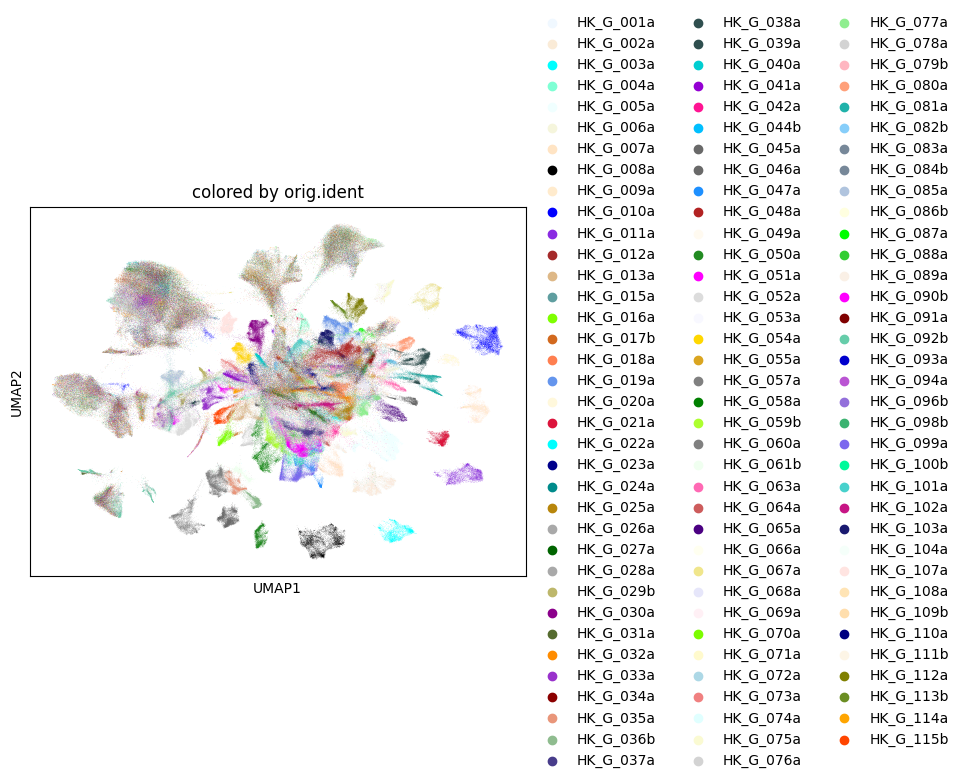

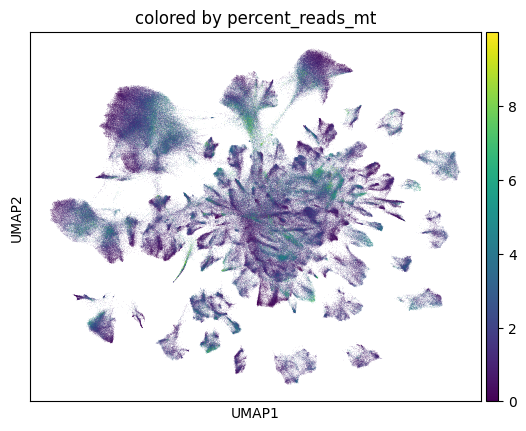

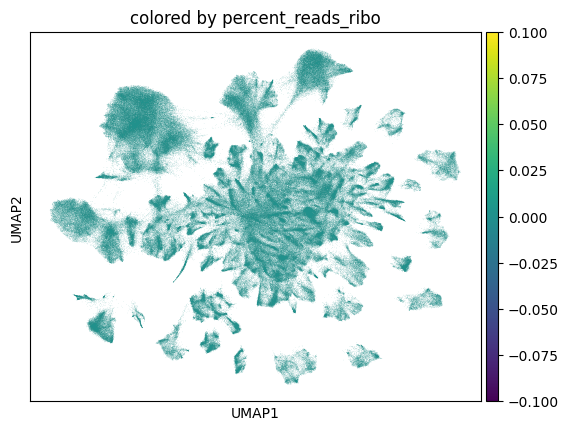

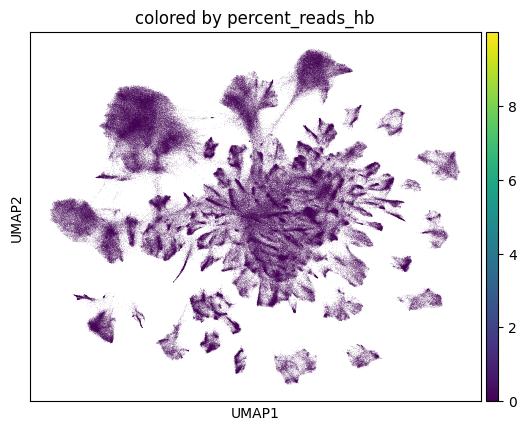

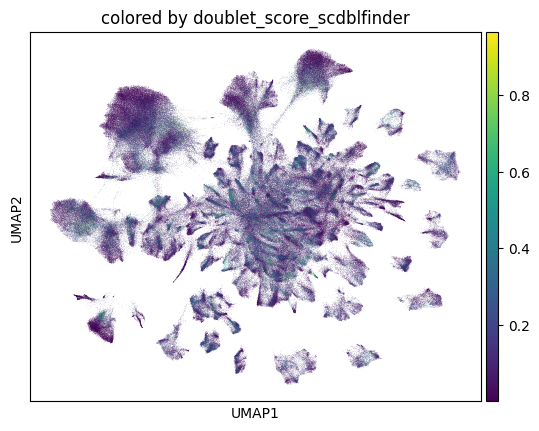

...

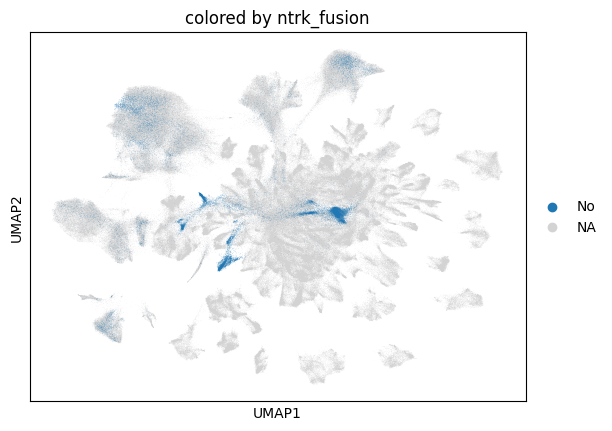

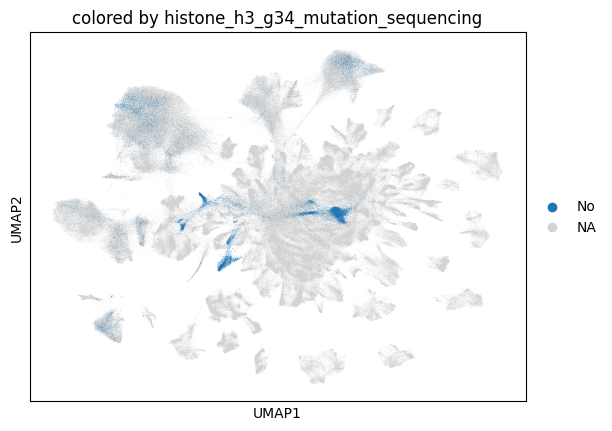

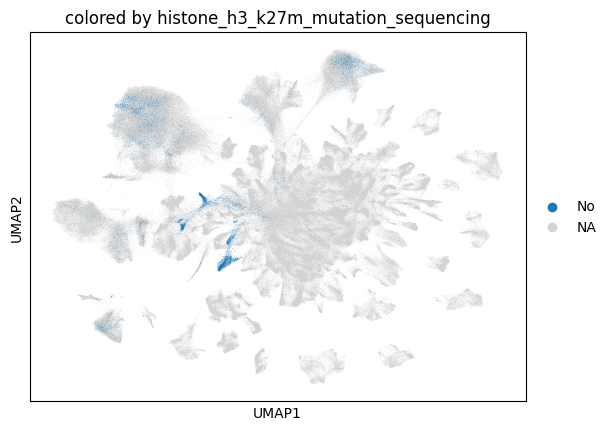

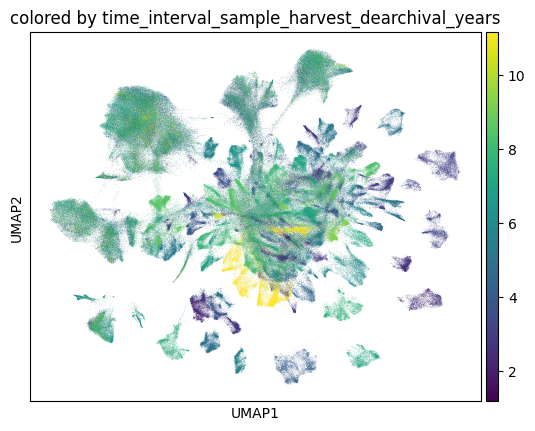

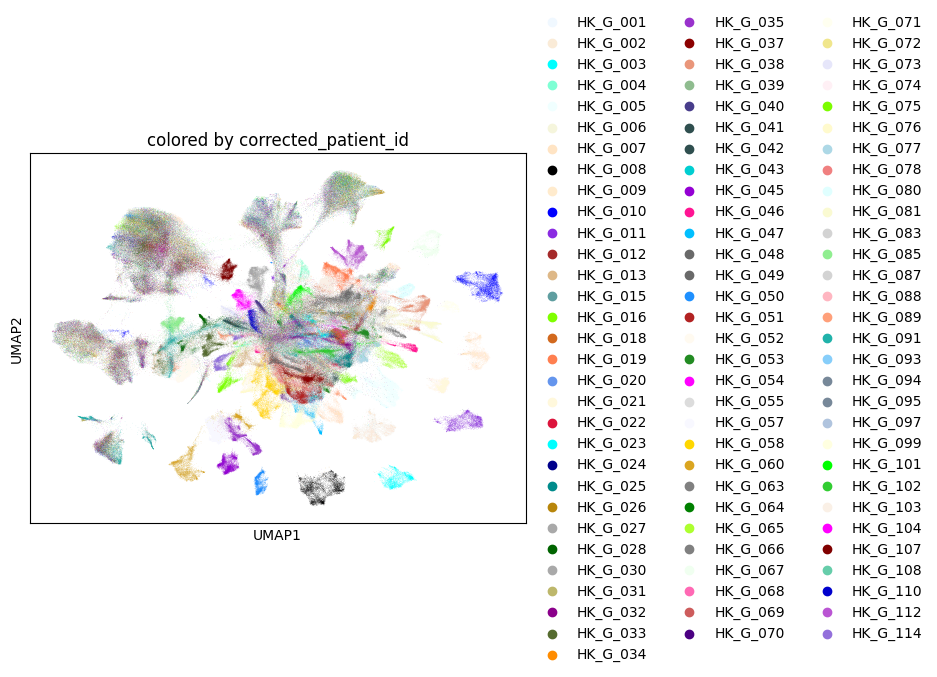

In [25]:
conditions=single_cell_obj.obs.columns
for c in conditions:
    if len(single_cell_obj.obs[c].unique())>10:
        sc.pl.umap(single_cell_obj, color=c, title=f"colored by {c}",palette=list(matplotlib.colors.CSS4_COLORS.values()))
    else:
        sc.pl.umap(single_cell_obj, color=c, title=f"colored by {c}")

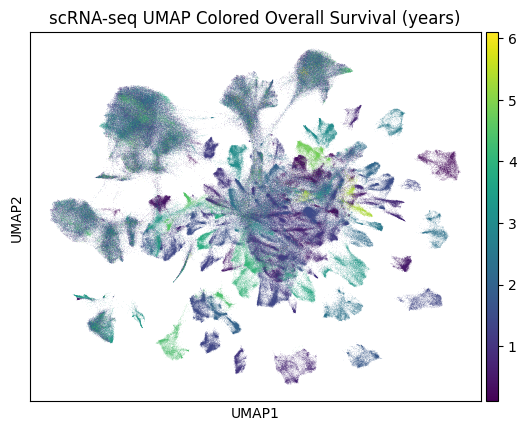

In [67]:
# plot high res
sc.pl.umap(single_cell_obj, color="os_years", title="scRNA-seq UMAP Colored Overall Survival (years)",palette=list(matplotlib.colors.CSS4_COLORS.values()),save="test.png",return_fig=True)
plt.savefig('tik.png',dpi=300)

# Differential Expression


==== Running DE analysis for Malignant ====
   Comparing os_years within Malignant...
   Identified groups: Low (comparison) vs High (reference)
   Number of unique patients per group for os_years_binarized in Malignant:
os_years_binarized
High     9
Low     98


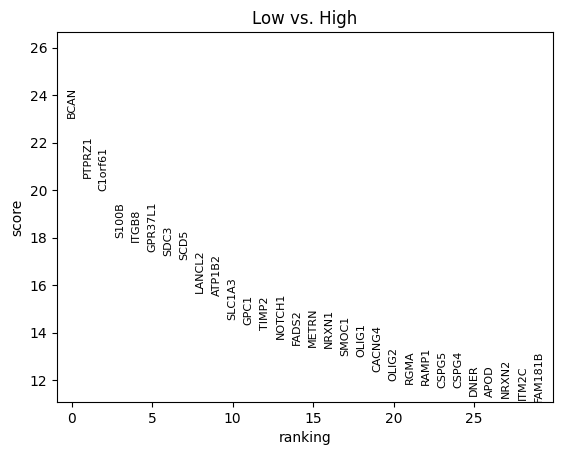

   Comparing pfs_years within Malignant...
   Identified groups: Low (comparison) vs High (reference)
   Number of unique patients per group for pfs_years_binarized in Malignant:
pfs_years_binarized
High    12
Low     95


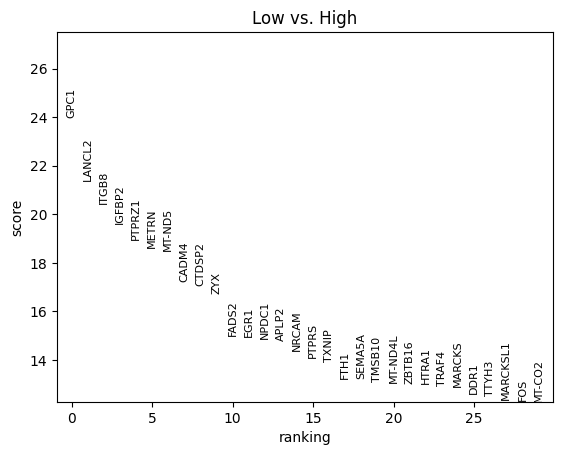


==== Running DE analysis for Immune ====
   Comparing os_years within Immune...
   Identified groups: Low (comparison) vs High (reference)
   Number of unique patients per group for os_years_binarized in Immune:
os_years_binarized
High     9
Low     98


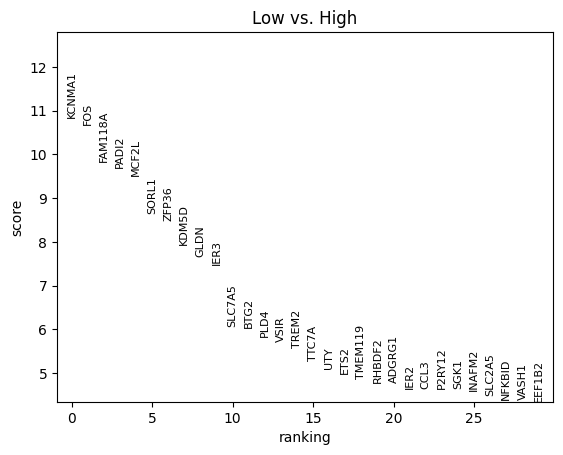

   Comparing pfs_years within Immune...
   Identified groups: Low (comparison) vs High (reference)
   Number of unique patients per group for pfs_years_binarized in Immune:
pfs_years_binarized
High    12
Low     95


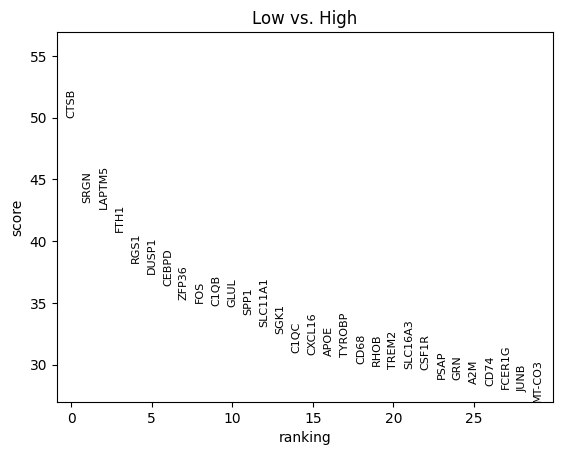


==== Running DE analysis for Stromal ====
   Comparing os_years within Stromal...
   Identified groups: Low (comparison) vs High (reference)
   Number of unique patients per group for os_years_binarized in Stromal:
os_years_binarized
High     9
Low     98


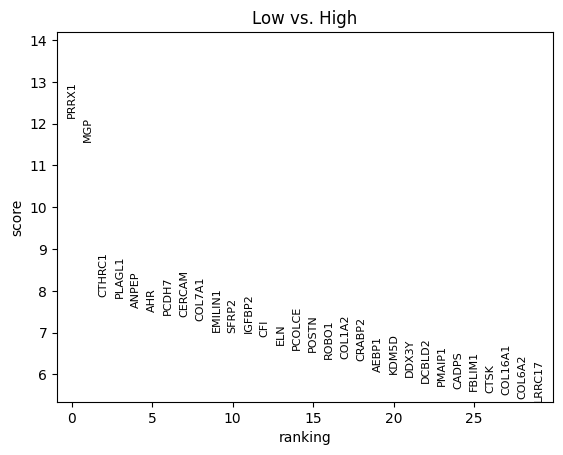

   Comparing pfs_years within Stromal...
   Identified groups: Low (comparison) vs High (reference)
   Number of unique patients per group for pfs_years_binarized in Stromal:
pfs_years_binarized
High    12
Low     95


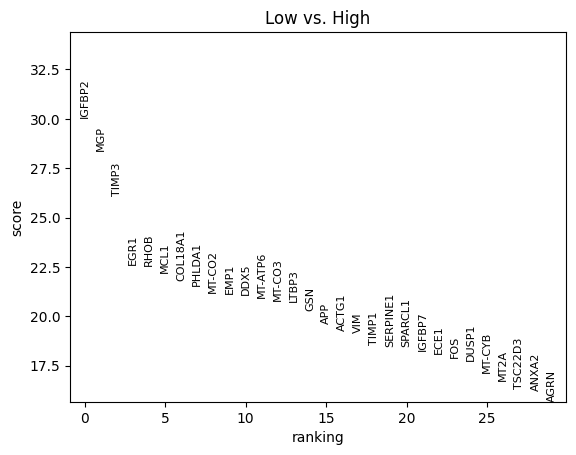


==== Running DE analysis for Neuroglia ====
   Comparing os_years within Neuroglia...
   Identified groups: High (comparison) vs Low (reference)
   Number of unique patients per group for os_years_binarized in Neuroglia:
os_years_binarized
High     9
Low     93


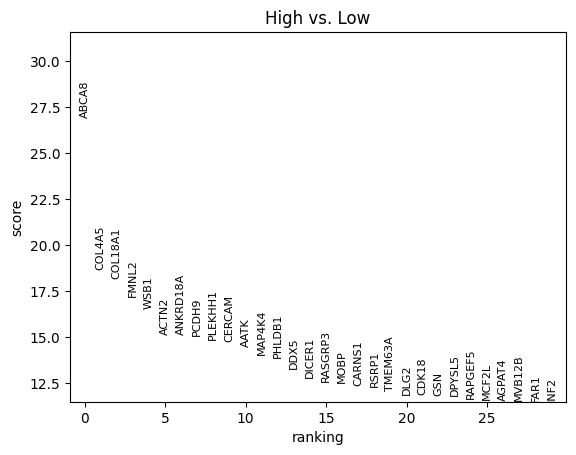

   Comparing pfs_years within Neuroglia...
   Identified groups: High (comparison) vs Low (reference)
   Number of unique patients per group for pfs_years_binarized in Neuroglia:
pfs_years_binarized
High    12
Low     90


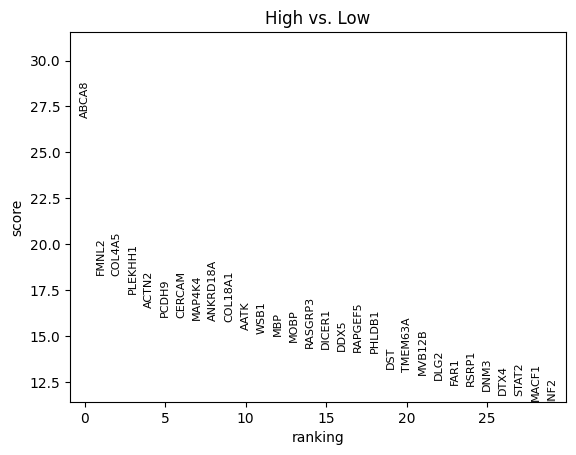


==== Running DE analysis for Neuron ====
   Comparing os_years within Neuron...
   Identified groups: High (comparison) vs Low (reference)
   Number of unique patients per group for os_years_binarized in Neuron:
os_years_binarized
High     8
Low     91


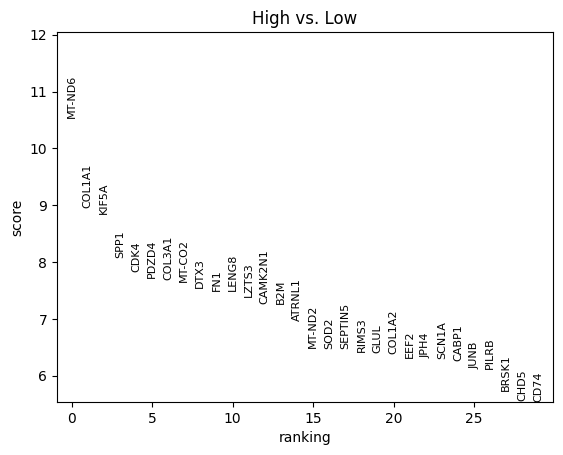

   Comparing pfs_years within Neuron...
   Identified groups: High (comparison) vs Low (reference)
   Number of unique patients per group for pfs_years_binarized in Neuron:
pfs_years_binarized
High    11
Low     88


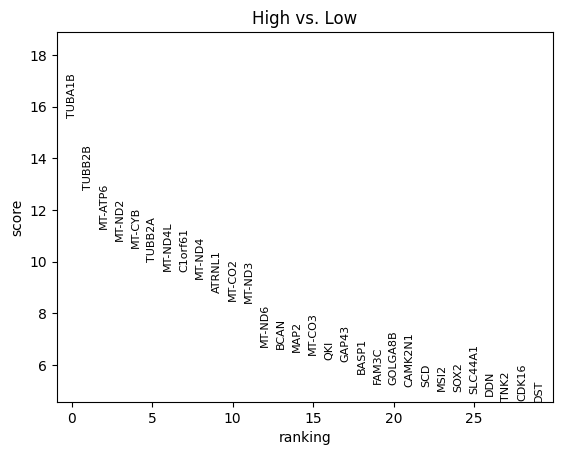

In [82]:
#clinical_factors = [
#    "mgmt_promoter_methylation",
#    "presence_of_small_cells",
#    "pfs_years",
#    "os_years"
#]

clinical_factors = [
    "os_years",
    "pfs_years"
]

cutoffs = {"os_years": 4, "pfs_years":2}

# Get all unique cell types
cell_types = single_cell_obj.obs["celltype_level1_scanvi"].unique()

# Dictionary to store DE results for each cell type and clinical factor
de_results = {}

for cell_type in cell_types:
    print(f"\n==== Running DE analysis for {cell_type} ====")

    # Subset data for the specific cell type
    adata_subset = single_cell_obj[single_cell_obj.obs["celltype_level1_scanvi"] == cell_type].copy()
    if adata_subset.n_obs > 50000:
        adata_subset = adata_subset[np.random.choice(adata_subset.n_obs, 50000, replace=False)]
    
    # Convert continuous variables to categorical based on cutoffs
    for factor in clinical_factors:
        print(f"   Comparing {factor} within {cell_type}...")

        if factor in cutoffs:
            cutoff = cutoffs[factor]
            adata_subset.obs.loc[:, f"{factor}_binarized"] = np.where(
                adata_subset.obs[factor] > cutoff, "High", "Low"
            )
            factor_to_use = f"{factor}_binarized"  # Use the binarized version
        else:
            factor_to_use = factor  # Use the original categorical variable

        # Ensure at least two groups exist
        unique_groups = adata_subset.obs[factor_to_use].dropna().unique()
        if len(unique_groups) < 2:
            print(f"   Skipping {factor} for {cell_type} (not enough groups).")
            continue

        # Identify the groups dynamically
        group1, group2 = unique_groups
        print(f"   Identified groups: {group1} (comparison) vs {group2} (reference)")

        patient_counts = adata_subset.obs.groupby(factor_to_use, observed=False)["patient_id"].nunique()

        # Print patient count per group
        print(f"   Number of unique patients per group for {factor_to_use} in {cell_type}:")
        print(patient_counts.to_string())

        # Remove NaN values before running DEA
        adata_filtered = adata_subset[~adata_subset.obs[factor_to_use].isna()].copy()

        # Run DEA only on valid (non-NaN) groups
        sc.tl.rank_genes_groups(adata_filtered, groupby=factor_to_use,groups=[group1],reference=group2, method="wilcoxon", use_raw=False)

        # Plot differential expression
        sc.pl.rank_genes_groups(adata_filtered, n_genes=30, sharey=False)
        #plt.savefig(f'dea.png',dpi=300)

        # Extract DE results correctly for both groups
        de_results_group = adata_filtered.uns["rank_genes_groups"]
        groups = list(de_results_group["names"].dtype.names)  # Get list of group names

        de_dfs = []
        for group in groups:
            de_df = pd.DataFrame({
                "gene": de_results_group["names"][group],
                "logfoldchange": de_results_group["logfoldchanges"][group],
                "pvals": de_results_group["pvals"][group],
                "pvals_adj": de_results_group["pvals_adj"][group]
            })
            de_df["comparison_group"] = group  # Add label for clarity
            de_dfs.append(de_df)

        # Combine results
        final_de_df = pd.concat(de_dfs, ignore_index=True)

        # Store results for this cell type & clinical factor
        key = f"{cell_type}_{factor}"
        de_results[key] = final_de_df

In [41]:
"NCAM1" in adata_filtered.var_names
print(de_results.keys())
de_results["Malignant_presence_of_small_cells"][de_results["Malignant_presence_of_small_cells"].gene=='NCAM1']

dict_keys(['Malignant_mgmt_promoter_methylation', 'Malignant_presence_of_small_cells', 'Malignant_pfs_years', 'Malignant_os_years', 'Immune_mgmt_promoter_methylation', 'Immune_presence_of_small_cells', 'Immune_pfs_years', 'Immune_os_years', 'Stromal_mgmt_promoter_methylation', 'Stromal_presence_of_small_cells', 'Stromal_pfs_years', 'Stromal_os_years', 'Neuroglia_mgmt_promoter_methylation', 'Neuroglia_presence_of_small_cells', 'Neuroglia_pfs_years', 'Neuroglia_os_years', 'Neuron_mgmt_promoter_methylation', 'Neuron_presence_of_small_cells', 'Neuron_pfs_years', 'Neuron_os_years'])


,gene,logfoldchange,pvals,pvals_adj,comparison_group
23,NCAM1,0.811038,7.715466e-114,5.735806e-111,No
35660,NCAM1,-0.811038,7.715466e-114,5.735806e-111,Yes


In [71]:
de_results["Malignant_os_years"][de_results["Malignant_os_years"].comparison_group=="Low"].to_csv("rank-lowsurvival.csv")

In [43]:
a=['PLP1', 'MBP', 'MOBP', 'COL6A3', 'CARNS1', 'PTGDS', 'ERMN', 'NKX6-2',
       'MOG', 'CLDN11', 'COL1A1', 'MYRF', 'LUM', 'CNDP1', 'COL3A1', 'MAL',
       'COL1A2', 'CNTN2', 'TRDC', 'LTBP2', 'SFRP2', 'ISLR', 'ENPP2', 'PTPRZ1',
       'CKB', 'PCOLCE', 'TF', 'C7', 'PCSK6', 'APLP1', 'FXYD6', 'COL14A1',
       'CXCL12', 'OLIG1', 'DCX', 'CNP', 'EDIL3', 'CSPG5', 'FAM107A', 'MTURN',
       'COL5A1', 'DCN', 'ST18', 'POSTN', 'RNASE1', 'GPM6A', 'ADAMTS2', 'SOX8',
       'MARCKSL1', 'PCDHGC3']

for gene in a:
    print(gene)
    print(de_results["Malignant_os_years"][de_results["Malignant_os_years"].gene==gene])

PLP1
       gene  logfoldchange         pvals     pvals_adj comparison_group
391    PLP1       0.768837  1.058059e-13  4.051047e-12             High
35292  PLP1      -0.768837  1.058059e-13  4.051047e-12              Low
MBP
      gene  logfoldchange         pvals     pvals_adj comparison_group
163    MBP       1.305019  1.216904e-23  1.074852e-21             High
35520  MBP      -1.305019  1.216904e-23  1.074852e-21              Low
MOBP
       gene  logfoldchange     pvals  pvals_adj comparison_group
5918   MOBP       1.193305  0.157178   0.412124             High
29765  MOBP      -1.193305  0.157178   0.412124              Low
COL6A3
         gene  logfoldchange     pvals  pvals_adj comparison_group
3393   COL6A3       1.729874  0.007172   0.033411             High
32290  COL6A3      -1.729874  0.007172   0.033411              Low
CARNS1
         gene  logfoldchange     pvals  pvals_adj comparison_group
6387   CARNS1       1.647129  0.217626   0.525267             High
29296  CARNS1

# Statitstical tests on distribution of cell types accross conditions

In [ ]:
patient_celltype_counts = single_cell_obj.obs.groupby(["patient_id", "celltype_level1_scanvi"],observed=False).size()
patient_celltype_matrix = patient_celltype_counts.reset_index(name="cell_count")

patients = patient_celltype_matrix["patient_id"].unique()
cell_types = patient_celltype_matrix["celltype_level1_scanvi"].unique()

final_matrix = pd.DataFrame(index=patients, columns=cell_types).fillna(0)

for _, row in patient_celltype_matrix.iterrows():
    final_matrix.at[row["patient_id"], row["celltype_level1_scanvi"]] = row["cell_count"]

print(final_matrix)

plt.figure(figsize = [10, 15])
sns.heatmap(final_matrix.astype(int))

In [ ]:
# Extract patient-level clinical information
patient_clinical_data = single_cell_obj.obs[["patient_id", "mgmt_promoter_methylation"]].drop_duplicates()

# Merge cell type matrix with clinical data
merged_data = final_matrix.merge(patient_clinical_data, left_index=True, right_on="patient_id")

merged_data

In [ ]:
# Count patients per clinical group
group_counts = merged_data["mgmt_promoter_methylation"].value_counts()
print("\nNumber of patients per clinical group:")
print(group_counts.to_string())

# Ensure we have exactly two groups for comparison
if len(group_counts) != 2:
    raise ValueError(f"Expected 2 groups, but found {len(group_counts)}: {group_counts.index.tolist()}")

In [52]:
#TODO

from scipy.stats import mannwhitneyu
import pandas as pd

merged_data_filtered = merged_data.dropna(subset=["mgmt_promoter_methylation"])

# Verify that only two unique groups remain
valid_groups = merged_data_filtered["mgmt_promoter_methylation"].unique()
if len(valid_groups) != 2:
    raise ValueError(f"Expected 2 groups after filtering NaNs, but found {len(valid_groups)}: {valid_groups}")
print(valid_groups)

# Extract the two groups
group1_name, group2_name = valid_groups
group1 = merged_data_filtered[merged_data_filtered["mgmt_promoter_methylation"] == group1_name]
group2 = merged_data_filtered[merged_data_filtered["mgmt_promoter_methylation"] == group2_name]

# Dictionary to store p-values
p_values = {}

# Loop over each cell type and perform test
for cell_type in final_matrix.columns:
    values_group1 = group1[cell_type].astype(float).values
    values_group2 = group2[cell_type].astype(float).values

NameError: name 'merged_data' is not defined